<a href="https://colab.research.google.com/github/AbhishekU05/SoC_Real-Time_Anomaly_Detection_in_Surveillance_Videos/blob/main/Model_training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

## Hyperparameters and Constants

Here, we define wether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 100

## Download and Prepare the Dataset

We will use the MOT17 dataset for training the custom YOLOv5 object detector.


In [ ]:
!fusermount -u /content/drive
!rm -rf /content/drive



fusermount: failed to unmount /content/drive: Invalid argument
Mounted at /content/drive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
# Define proper structure
import os

base_path = '/content/drive/MyDrive/SoC/MOT17'
output_path = '/content/drive/MyDrive/SoC/dataset'

# Clean and recreate correct structure
!rm -rf $output_path
for split in ['train', 'val']:
    os.makedirs(f'{output_path}/{split}/images', exist_ok=True)
    os.makedirs(f'{output_path}/{split}/labels', exist_ok=True)
os.makedirs(f'{output_path}/test/images', exist_ok=True)


In [ ]:
# Converter function
import pandas as pd
import shutil
from tqdm import tqdm
import cv2

def convert_gt_to_yolo(gt_file, img_folder, output_img_folder, output_lbl_folder, img_ext='.jpg'):

    # Load annotations
    df = pd.read_csv(gt_file, header=None)
    df.columns = ['frame', 'id', 'x', 'y', 'w', 'h', 'conf', 'class', 'vis']

    # Ensure output folders exist
    os.makedirs(output_img_folder, exist_ok=True)
    os.makedirs(output_lbl_folder, exist_ok=True)

    # Process each frame
    for frame_id in tqdm(df['frame'].unique(), desc="Processing frames"):
        img_name = f'{frame_id:06d}{img_ext}'
        src_img_path = os.path.join(img_folder, img_name)
        dst_img_path = os.path.join(output_img_folder, img_name)

        if not os.path.exists(src_img_path):
            continue

        # Load image to get width/height
        img = cv2.imread(src_img_path)
        if img is None:
            continue
        h, w = img.shape[:2]

        # Filter to pedestrian annotations
        annots = df[df['frame'] == frame_id]
        annots = annots[annots['class'] == 1]

        # Skip if no pedestrians
        if annots.empty:
            continue

        # Copy image
        shutil.copy2(src_img_path, dst_img_path)

        # Write YOLO label file
        label_path = os.path.join(output_lbl_folder, img_name.replace(img_ext, '.txt'))
        with open(label_path, 'w') as f:
            for _, row in annots.iterrows():
                xc = (row['x'] + row['w'] / 2) / w
                yc = (row['y'] + row['h'] / 2) / h
                ww = row['w'] / w
                hh = row['h'] / h

                # Skip if any value is out of bounds
                if not (0 <= xc <= 1 and 0 <= yc <= 1 and 0 <= ww <= 1 and 0 <= hh <= 1):
                    continue

                f.write(f"0 {xc:.6f} {yc:.6f} {ww:.6f} {hh:.6f}\n")



In [ ]:
# Run on one train and one val sequence
train_seq = 'MOT17-02-FRCNN'
val_seq = 'MOT17-04-FRCNN'
test_seq = 'MOT17-05-FRCNN'

# Train
convert_gt_to_yolo(
    gt_file=f'{base_path}/train/{train_seq}/gt/gt.txt',
    img_folder=f'{base_path}/train/{train_seq}/img1',
    output_img_folder=f'{output_path}/train/images',
    output_lbl_folder=f'{output_path}/train/labels'
)

# Val
convert_gt_to_yolo(
    gt_file=f'{base_path}/train/{val_seq}/gt/gt.txt',
    img_folder=f'{base_path}/train/{val_seq}/img1',
    output_img_folder=f'{output_path}/val/images',
    output_lbl_folder=f'{output_path}/val/labels'
)

# Test — only images
img_src_folder = f'{base_path}/train/{test_seq}/img1'
img_dst_folder = f'{output_path}/test/images'

for fname in tqdm(sorted(os.listdir(img_src_folder))):
    if fname.endswith('.jpg'):
        shutil.copy2(os.path.join(img_src_folder, fname), os.path.join(img_dst_folder, fname))


100%|██████████| 837/837 [00:20<00:00, 39.97it/s]


In [ ]:
# Create data.yaml with correct structure
yaml_content = f"""
train: {output_path}/train/images
val: {output_path}/val/images
test: {output_path}/test/images

nc: 1
names: ['pedestrian']
"""

with open(f'{output_path}/data.yaml', 'w') as f:
    f.write(yaml_content)


The dataset is structured in the following manner:

```
├── data.yaml
├── test
│   └── images
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

## Helper Functions to Download Files

The following function is for downloading any file in the notebook. In further sections of the notebook, we will use it for downloading the inference data.

In [ ]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else:
        print('File already present, skipping download...')

### The Dataset YAML File

The dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels is already provided. This file will also contain the class names from the dataset.

The dataset contains only 1 classes: **'pedestrian'**.

The following block shows the contents of the `data.yaml` file.

```yaml
train: /content/drive/MyDrive/SoC/dataset/train/images
val: /content/drive/MyDrive/SoC/dataset/val/images
test: /content/drive/MyDrive/SoC/dataset/test/images

nc: 1
names: ['pedestrian']
```

### Visualize a Few Ground Truth Images

Before moving forward, let's check out few of the ground truth images.

The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. Let's write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format.

In [ ]:
class_names = ['Pedestrian']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        )

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

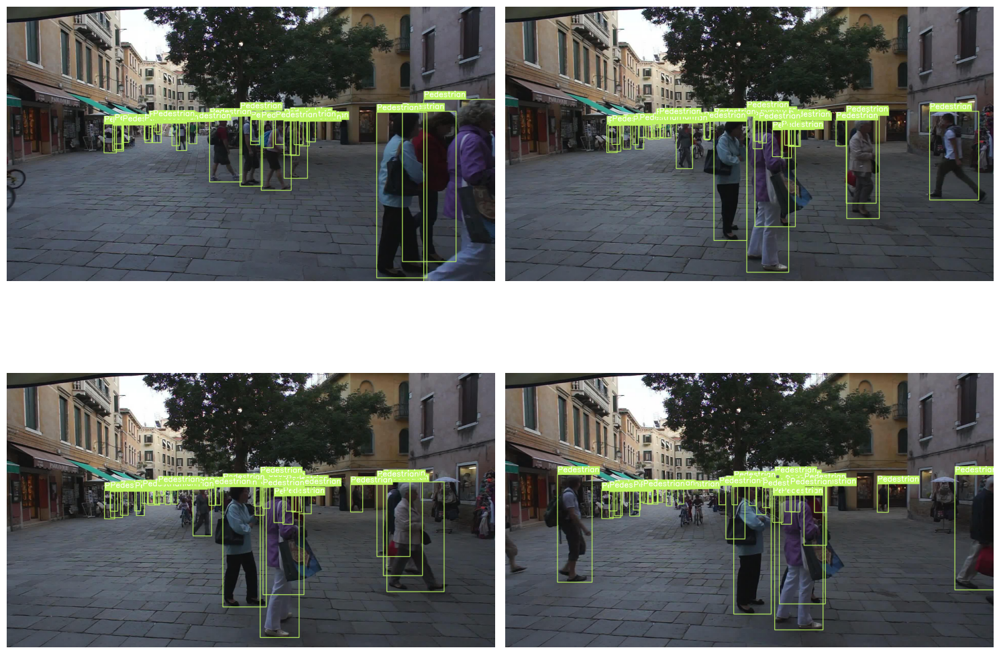

In [ ]:
# Visualize a few training images.
plot(
    image_paths='/content/drive/MyDrive/SoC/dataset/train/images/*',
    label_paths='/content/drive/MyDrive/SoC/dataset/train/labels/*',
    num_samples=4,
)

## Helper Functions for Logging

Here, we write the helper functions that we need for logging of the results in the notebook while training the models.

Let's create our custom result directories so that we can easily keep track of them and carry out inference using the proper model.

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 17511, done.
remote: Counting objects: 100% (20/20), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 17511 (delta 5), reused 0 (delta 0), pack-reused 17491 (from 3)
Receiving objects: 100% (17511/17511), 16.62 MiB | 14.04 MiB/s, done.
Resolving deltas: 100% (12000/12000), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 129.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 63.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 109.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 47.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

## Training using YOLOV5

The next step is to train the neural network model.

### Train a Small (yolov5s) Model

Training all the layers of the small model.

In [ ]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/SoC/dataset/data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 0
results_1
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-06-23 13:26:36.089979: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750685196.137537    1709 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750685196.150362    1709 cuda_blas.cc:1418] Unable to register cuBLAS factory: A

## Check Out the Validation Predictions

In this section, we will check out the predictions of the validation images saved during training.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

We may also need to visualize images in any of the directories. The following function accepts a directory path and plots all the images in them.

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

**Visualize validation prediction images.**

confusion_matrix.png				    results.png
events.out.tfevents.1750685229.80c2d76fa036.1709.0  train_batch0.jpg
F1_curve.png					    train_batch1.jpg
hyp.yaml					    train_batch2.jpg
labels_correlogram.jpg				    val_batch0_labels.jpg
labels.jpg					    val_batch0_pred.jpg
opt.yaml					    val_batch1_labels.jpg
P_curve.png					    val_batch1_pred.jpg
PR_curve.png					    val_batch2_labels.jpg
R_curve.png					    val_batch2_pred.jpg
results.csv					    weights
['runs/train/results_1/val_batch2_pred.jpg', 'runs/train/results_1/val_batch0_pred.jpg', 'runs/train/results_1/val_batch1_pred.jpg']


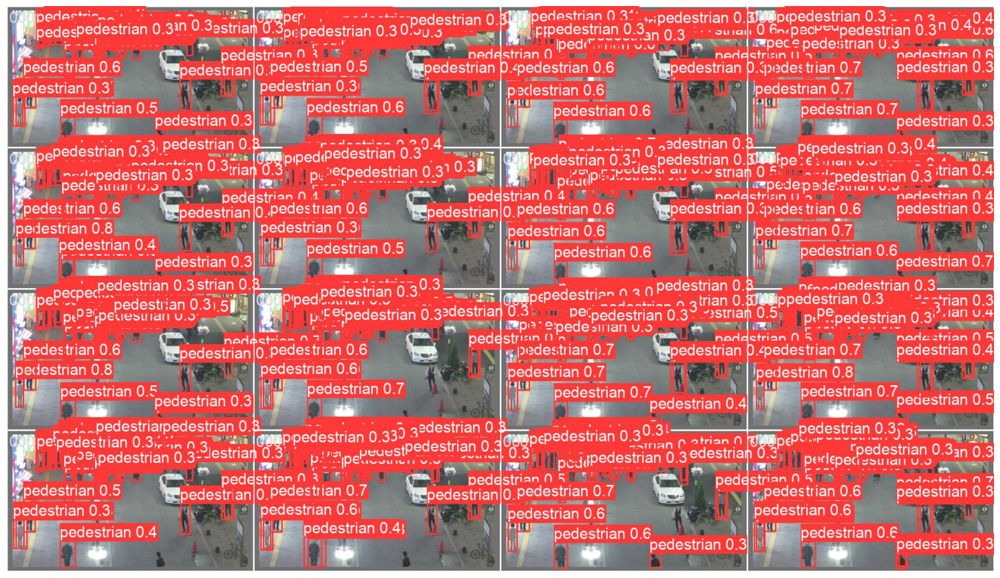

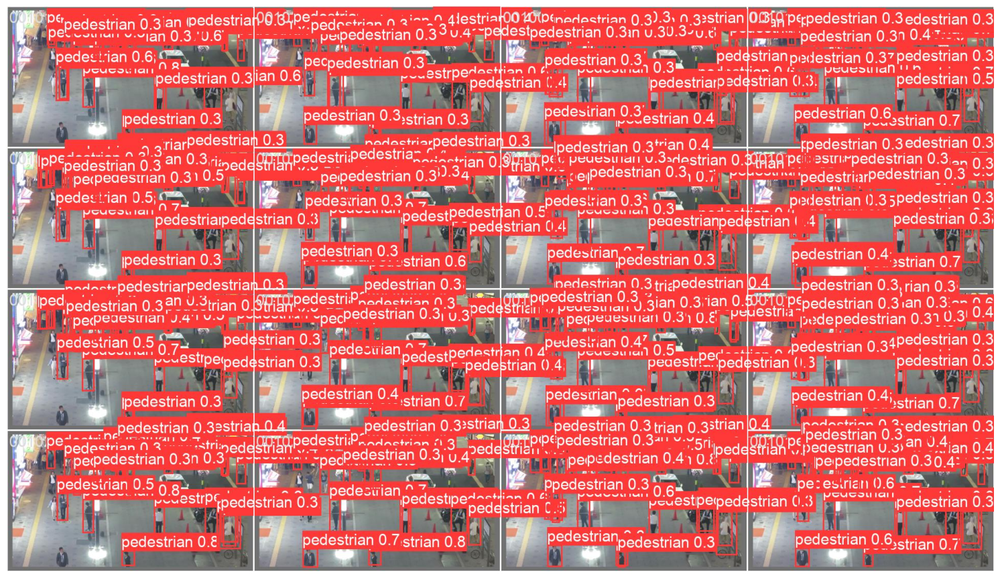

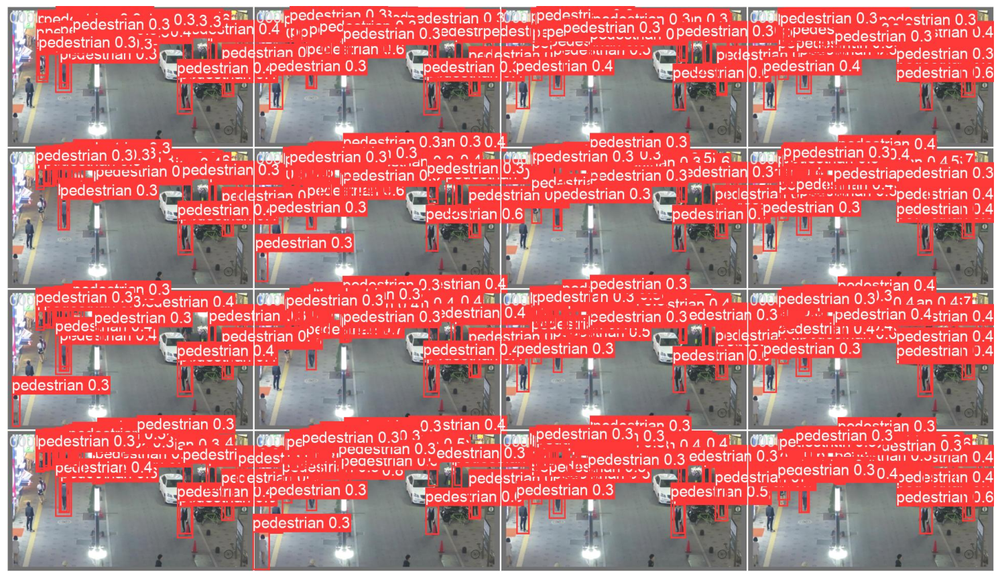

In [ ]:
show_valid_results(RES_DIR)

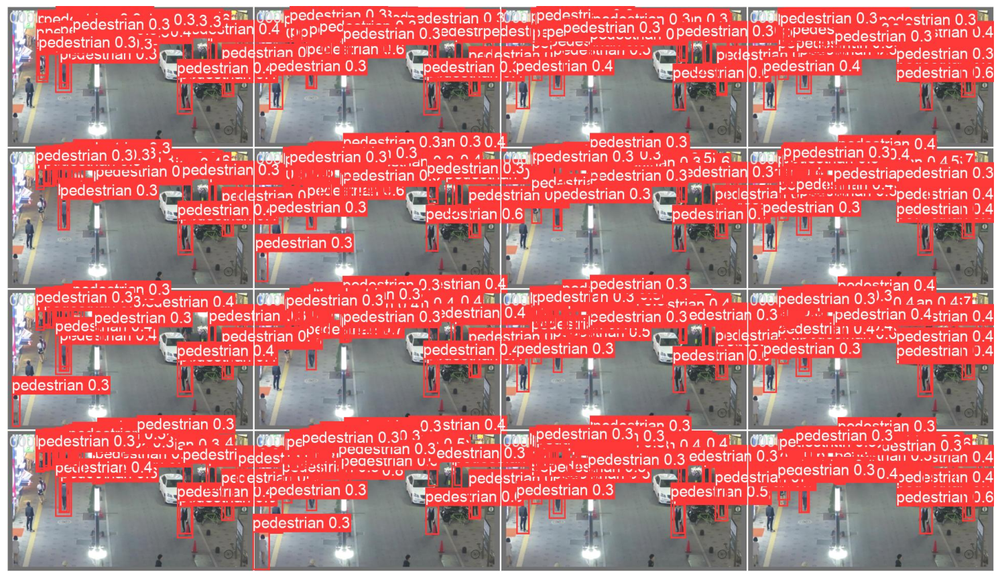

## Training and Inference using  Medium Model

In [ ]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1606), started 0:36:37 ago. (Use '!kill 1606' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/SoC/dataset/data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 1
results_2
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-06-23 14:04:33.415073: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750687473.437101   13001 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750687473.443614   13001 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 
wandb: W&B disabled due to login timeout.
train: weights=yolov5m.pt, c

## Freezing Layers and Training the Medium Model

The Medium model (yolov5m) contains 25 blocks layers in total more than 20 million parameters. We need not train all the layers. Let's freeze a few layers and train again. This will result in faster iteration per epoch. Here, we freeze the first 15 blocks.

In [ ]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 13752), started 0:47:16 ago. (Use '!kill 13752' to kill it.)

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data /content/drive/MyDrive/SoC/dataset/data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Streaming output truncated to the last 5000 lines.
  with torch.cuda.amp.autocast(amp):
      38/99      2.76G    0.05115    0.07744          0        926        640:  42% 16/38 [00:11<00:16,  1.35it/s]/content/yolov5/train.py:414: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
      38/99      2.76G    0.05119    0.07764          0        885        640:  45% 17/38 [00:12<00:19,  1.08it/s]/content/yolov5/train.py:414: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
      38/99      2.76G    0.05118    0.07754          0       1018        640:  47% 18/38 [00:13<00:14,  1.42it/s]/content/yolov5/train.py:414: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):


# Comparing the models

Now, we shall compare all three models:

*   Yolov5s
*   Yolov5m
*   Yolov5m with first 15 layers frozen

## Yolov5s
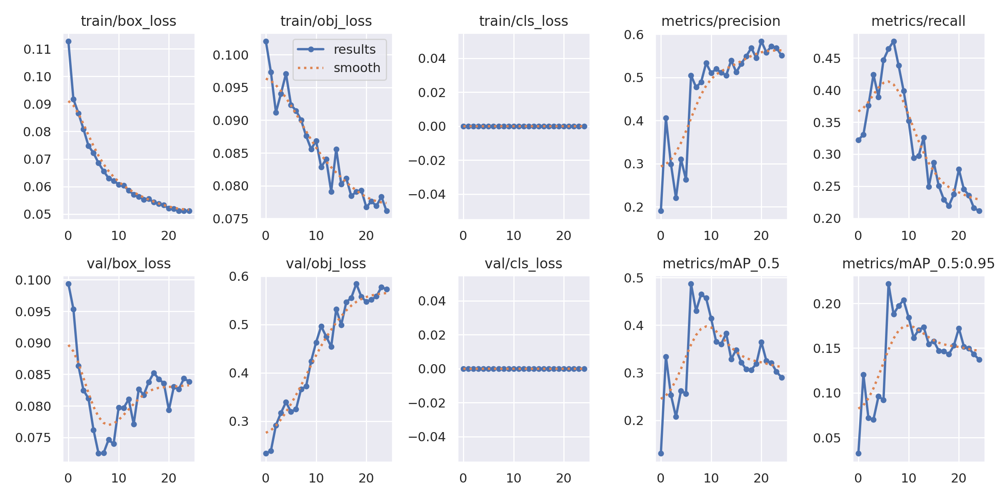



## Yolov5m

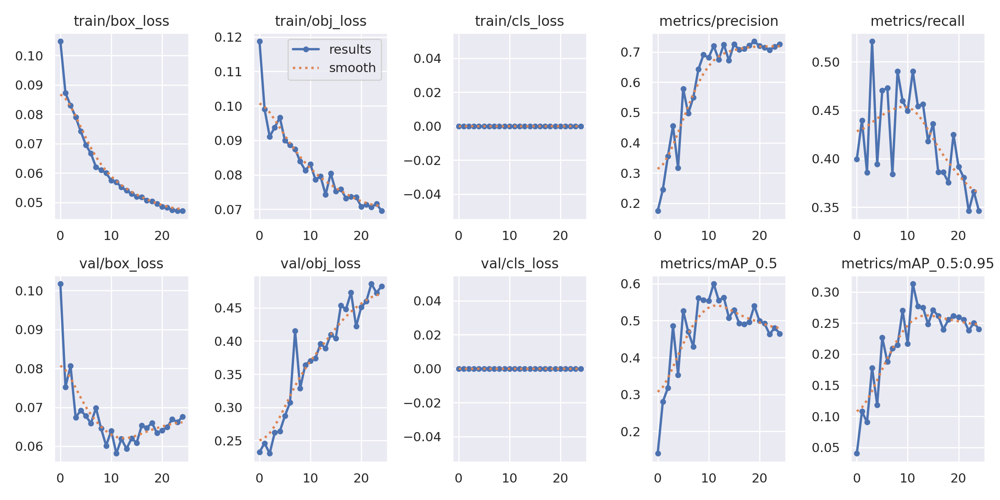

## Yolov5m (Frozen Layers)

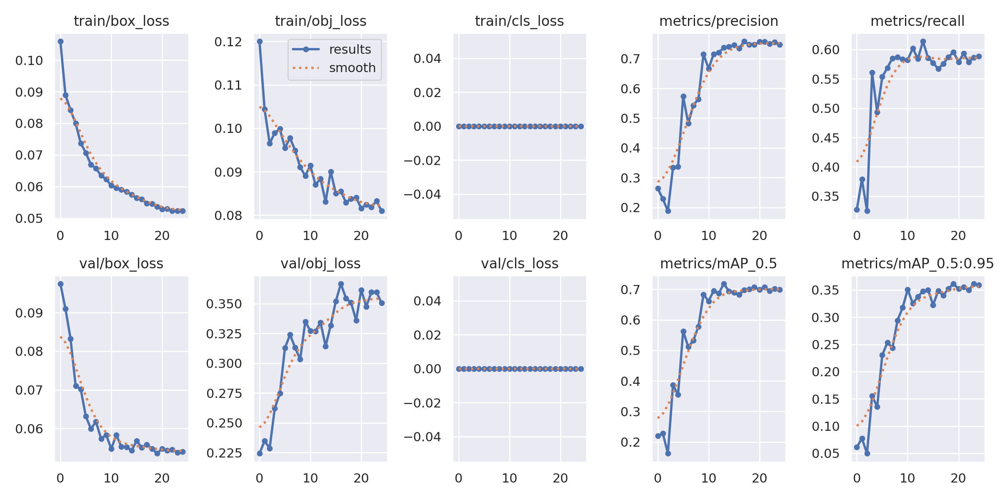

### YOLOv5 Model Performance Comparison on MOT Dataset

| Model Variant         | Frozen Layers | Precision (P) | Recall (R) | mAP@0.5 | mAP@0.5:0.95 |
|-----------------------|----------------|---------------|------------|---------|--------------|
| YOLOv5s               | No           | 0.680         | 0.410      | 0.540   | 0.270        |
| YOLOv5m               | No           | 0.720         | 0.490      | 0.600   | 0.313        |
| YOLOv5m               | Yes          | **0.747**     | **0.596**  | **0.707** | **0.361**    |

**Summary:**  
- YOLOv5m outperforms YOLOv5s on all metrics, as expected due to its larger capacity.
- Freezing layers in YOLOv5m leads to the best overall results, especially in Recall and mAP, suggesting better transfer learning from pretrained weights on the MOT dataset.
